In [1]:
import numpy as np
import matplotlib.pyplot as plt
import tifffile
import os
import cv2
from PIL import Image
from datasets import Dataset
from transformers import SamProcessor
from torch.utils.data import DataLoader
from torchvision import transforms

c:\Users\Utente\AppData\Local\Programs\Python\Python312\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


The following code cell takes both images and masks (previously converted to tiff format using 'ImageMagick Display') and resizes them using the PIL library. After being resized, they are saved in two separate folders inside our directory. The correspondence between images and masks is checked to be alright. Our next challenge is about masks not being 0-255 pixel arrays.

In [2]:
width = 1060
height = 400

In [3]:
#Funzione per fare il resize dell'immagine
def resize_image(image_path, width, height): 
    image = Image.open(image_path)
    resized_image = image.resize((width, height))
    return resized_image

In [4]:
directory_images = "Images\\Image tifs"
images = []
image_filenames = sorted(os.listdir(directory_images))
dir_save_images = "Images\\Image tifs\\resized_images"

for filename in image_filenames:
    if filename.endswith(".tif"):
        image_path = os.path.join(directory_images, filename)
        resized_image = resize_image(image_path, width, height)
        images.append(resized_image) #List of images in PIL format

if not os.path.exists(dir_save_images): #If the directory does not exist, it is created.
    os.makedirs(dir_save_images)

for i, image in enumerate(images):
    filename = f"image_{i+1}.tif"
    file_path = os.path.join(dir_save_images, filename)
    
    image.save(file_path)

    print(f"Image {i+1} saved as {file_path}")

Image 1 saved as Images\Image tifs\resized_images\image_1.tif
Image 2 saved as Images\Image tifs\resized_images\image_2.tif
Image 3 saved as Images\Image tifs\resized_images\image_3.tif
Image 4 saved as Images\Image tifs\resized_images\image_4.tif
Image 5 saved as Images\Image tifs\resized_images\image_5.tif
Image 6 saved as Images\Image tifs\resized_images\image_6.tif
Image 7 saved as Images\Image tifs\resized_images\image_7.tif
Image 8 saved as Images\Image tifs\resized_images\image_8.tif
Image 9 saved as Images\Image tifs\resized_images\image_9.tif
Image 10 saved as Images\Image tifs\resized_images\image_10.tif
Image 11 saved as Images\Image tifs\resized_images\image_11.tif
Image 12 saved as Images\Image tifs\resized_images\image_12.tif
Image 13 saved as Images\Image tifs\resized_images\image_13.tif
Image 14 saved as Images\Image tifs\resized_images\image_14.tif
Image 15 saved as Images\Image tifs\resized_images\image_15.tif
Image 16 saved as Images\Image tifs\resized_images\image_1

In [14]:
directory_masks = "Segmentation1\\converted_tifs"
masks = []
mask_filenames = sorted(os.listdir(directory_masks))
save_masks = "Segmentation1\\converted_tifs\\resized_masks"

for filename in mask_filenames:
    if filename.endswith(".tif"):
        image_path = os.path.join(directory_masks, filename)
        resized_image = resize_image(image_path, width, height)
        masks.append(resized_image)

if not os.path.exists(save_masks):
    os.makedirs(save_masks)

for i, mask_image in enumerate(masks):
    maskname = f"mask_{i+1}.tif"
    file_path = os.path.join(save_masks, maskname)
    
    mask_image.save(file_path)

    print(f"Mask {i+1} saved as {file_path}")

Mask 1 saved as Segmentation1\converted_tifs\resized_masks\mask_1.tif
Mask 2 saved as Segmentation1\converted_tifs\resized_masks\mask_2.tif
Mask 3 saved as Segmentation1\converted_tifs\resized_masks\mask_3.tif
Mask 4 saved as Segmentation1\converted_tifs\resized_masks\mask_4.tif
Mask 5 saved as Segmentation1\converted_tifs\resized_masks\mask_5.tif
Mask 6 saved as Segmentation1\converted_tifs\resized_masks\mask_6.tif
Mask 7 saved as Segmentation1\converted_tifs\resized_masks\mask_7.tif
Mask 8 saved as Segmentation1\converted_tifs\resized_masks\mask_8.tif
Mask 9 saved as Segmentation1\converted_tifs\resized_masks\mask_9.tif
Mask 10 saved as Segmentation1\converted_tifs\resized_masks\mask_10.tif
Mask 11 saved as Segmentation1\converted_tifs\resized_masks\mask_11.tif
Mask 12 saved as Segmentation1\converted_tifs\resized_masks\mask_12.tif
Mask 13 saved as Segmentation1\converted_tifs\resized_masks\mask_13.tif
Mask 14 saved as Segmentation1\converted_tifs\resized_masks\mask_14.tif
Mask 15 sa

Let us create a 'dataset' that serves us input images and masks for the rest of our journey.

First, we convert the images from greyscale to RGB - Glauco

In [15]:
dataset_dict = {
    "image": [img for img in images],
    "label": [mask for mask in masks], 
}

In [16]:
#Here we add a dimension: channels. This is extremely important for some cells below.

for i in range(len(dataset_dict["image"])):
    dataset_dict["image"][i] = transforms.functional.to_tensor(dataset_dict["image"][i]).unsqueeze(0)

for i in range(len(dataset_dict["label"])):
    dataset_dict["label"][i] = transforms.functional.to_tensor(dataset_dict["label"][i]).unsqueeze(0)

# Create the dataset using the datasets.Dataset class
dataset = Dataset.from_dict(dataset_dict)

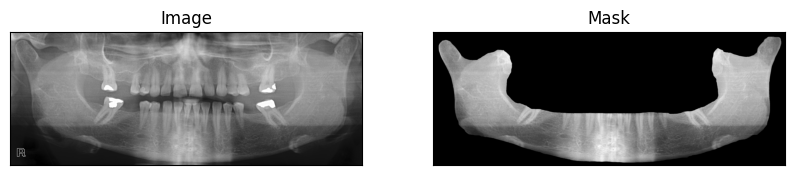

In [21]:
for i in range(115):
    example_image = dataset[1]["image"][0][0]
    example_mask = dataset[1]["label"][0][0]

    fig, axes = plt.subplots(1, 2, figsize=(10, 5))

    # Plot the first image on the left
    axes[0].imshow(np.array(example_image), cmap='gray')  # Assuming the first image is grayscale
    axes[0].set_title("Image")

    # Plot the second image on the right
    axes[1].imshow(example_mask, cmap='gray')  # Assuming the second image is grayscale
    axes[1].set_title("Mask")

    # Hide axis ticks and labels
    for ax in axes:
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_xticklabels([])
        ax.set_yticklabels([])

    # Display the images side by side
    plt.show()

    break

In [8]:
print(type(dataset))

<class 'datasets.arrow_dataset.Dataset'>


In [14]:
for example in range(5):
    print(type(dataset[example]))


<class 'dict'>
<class 'dict'>
<class 'dict'>
<class 'dict'>
<class 'dict'>


In [22]:
example = dataset[0]

In [23]:
for key, value in example.items():
    print(type(key), type(value))

<class 'str'> <class 'list'>
<class 'str'> <class 'list'>


In [24]:
for key, value in example.items():
    print(key, value)

image [[[[0.8549019694328308, 0.8235294222831726, 0.8313725590705872, 0.7843137383460999, 0.7764706015586853, 0.7803921699523926, 0.772549033164978, 0.7568627595901489, 0.7450980544090271, 0.7568627595901489, 0.7843137383460999, 0.7803921699523926, 0.7607843279838562, 0.7607843279838562, 0.7843137383460999, 0.8078431487083435, 0.8117647171020508, 0.843137264251709, 0.8745098114013672, 0.8901960849761963, 0.9098039269447327, 0.9137254953384399, 0.9176470637321472, 0.9372549057006836, 0.9529411792755127, 0.9764705896377563, 0.9843137264251709, 0.9725490212440491, 0.9764705896377563, 0.9725490212440491, 0.9647058844566345, 0.9647058844566345, 0.9411764740943909, 0.9254902005195618, 0.9333333373069763, 0.9058823585510254, 0.8980392217636108, 0.8823529481887817, 0.8705882430076599, 0.8509804010391235, 0.8313725590705872, 0.8509804010391235, 0.843137264251709, 0.843137264251709, 0.8392156958580017, 0.8392156958580017, 0.8509804010391235, 0.8705882430076599, 0.8549019694328308, 0.850980401039

Let us make sure out images and masks (labels) are loading appropriately

Get bounding boxes from masks. You can get here directly if you are working with coco style annotations where bounding boxes are captured in a JSON file.

In [17]:
def get_bounding_box(ground_truth_map):
    # Reshape ground_truth_map to 2D array
    mask_2d = ground_truth_map[0, 0, :, :]  # Collapse first two dimensions
    
    # Get bounding box from mask
    y_indices, x_indices = np.where(mask_2d > 0)
    x_min, x_max = np.min(x_indices), np.max(x_indices)
    y_min, y_max = np.min(y_indices), np.max(y_indices)
    
    # Add perturbation to bounding box coordinates
    H, W = mask_2d.shape
    x_min = max(0, x_min - np.random.randint(0, 20))
    x_max = min(W, x_max + np.random.randint(0, 20))
    y_min = max(0, y_min - np.random.randint(0, 20))
    y_max = min(H, y_max + np.random.randint(0, 20))
    
    bbox = [x_min, y_min, x_max, y_max]

    return bbox

In [ ]:
print(type(dataset))

In [ ]:
print(dataset.features)

In [ ]:
print(len(dataset))

In [12]:
# Access the first example in the dataset
first_example = dataset[0]

# Access the image and label from the first example
first_image = first_example['image']
first_label = first_example['label']

# Check the types
print("Type of the first image:", (first_image[0]))
#print("Type of the first label:", type(first_label))


Type of the first image: [[[0.8549019694328308, 0.8235294222831726, 0.8313725590705872, 0.7843137383460999, 0.7764706015586853, 0.7803921699523926, 0.772549033164978, 0.7568627595901489, 0.7450980544090271, 0.7568627595901489, 0.7843137383460999, 0.7803921699523926, 0.7607843279838562, 0.7607843279838562, 0.7843137383460999, 0.8078431487083435, 0.8117647171020508, 0.843137264251709, 0.8745098114013672, 0.8901960849761963, 0.9098039269447327, 0.9137254953384399, 0.9176470637321472, 0.9372549057006836, 0.9529411792755127, 0.9764705896377563, 0.9843137264251709, 0.9725490212440491, 0.9764705896377563, 0.9725490212440491, 0.9647058844566345, 0.9647058844566345, 0.9411764740943909, 0.9254902005195618, 0.9333333373069763, 0.9058823585510254, 0.8980392217636108, 0.8823529481887817, 0.8705882430076599, 0.8509804010391235, 0.8313725590705872, 0.8509804010391235, 0.843137264251709, 0.843137264251709, 0.8392156958580017, 0.8392156958580017, 0.8509804010391235, 0.8705882430076599, 0.85490196943283

In [18]:
#Original code

class SAMDataset(Dataset):
  """
  This class is used to create a dataset that serves input images and masks.
  It takes a dataset and a processor as input and overrides the __len__ and __getitem__ methods of the Dataset class.
  """
  def __init__(self, dataset, processor):
    self.dataset = dataset
    self.processor = processor

  def __len__(self):
    return len(self.dataset)

  def __getitem__(self, idx):
    item = self.dataset[idx]
    image = item["image"]
    ground_truth_mask = np.array(item["label"])

    # get bounding box prompt
    prompt = get_bounding_box(ground_truth_mask)

    # prepare image and prompt for the model
    inputs = self.processor(image, input_boxes=[[prompt]], return_tensors="pt")

    # remove batch dimension which the processor adds by default
    inputs = {k:v.squeeze(0) for k,v in inputs.items()}

    # add ground truth segmentation
    inputs["ground_truth_mask"] = ground_truth_mask

    return inputs
  
  

In [23]:
class SAMDataset(Dataset):
    """
    This class is used to create a dataset that serves input images and masks.
    It takes a dataset and a processor as input and overrides the __len__ and __getitem__ methods of the Dataset class.
    """
    def __init__(self, dataset, processor):
        self.dataset = dataset
        self.processor = processor

    def __len__(self):
        return len(self.dataset)

    def __getitem__(self, idx):
        item = self.dataset[idx]
        image = item["image"]
        ground_truth_mask = np.array(item["label"])

        # Convert image to numpy array if it's a list
        if isinstance(image, list):
            image = np.array(image)
            print(image)

        # Get bounding box prompt
        bbox = get_bounding_box(ground_truth_mask)

        print(image.shape)
        
        # Prepare image and prompt for the model
        inputs = self.processor(image, input_boxes=[bbox], return_tensors="pt", do_rescale=False, mean = 0.5)

        # Remove batch dimension which the processor adds by default
        inputs = {k: v.squeeze(0) for k, v in inputs.items()}

        # Add ground truth segmentation
        inputs["ground_truth_mask"] = ground_truth_mask

        return inputs

  
  

Investigate the documentation for your specific SamProcessor version to confirm supported arguments for image normalization.

In [28]:
class SAMDataset(Dataset):
    """
    This class is used to create a dataset that serves input images and masks.
    It takes a dataset and a processor as input and overrides the __len__ and __getitem__ methods of the Dataset class.
    """
    def __init__(self, dataset, processor):
        self.dataset = dataset
        self.processor = processor

    def __len__(self):
        return len(self.dataset)

    def __getitem__(self, idx):
        item = self.dataset[idx]
        image = item["image"]
        ground_truth_mask = np.array(item["label"])

        # Convert image to numpy array if it's a list
        if isinstance(image, list):
            image = np.array(image)
            print(image)

        # Get bounding box prompt
        bbox = get_bounding_box(ground_truth_mask)

        print(image.shape)
        
        # Prepare image and prompt for the model
        inputs = self.processor(image, input_boxes=[bbox], return_tensors="pt", do_rescale=False)

        # Remove batch dimension which the processor adds by default
        inputs = {k: v.squeeze(0) for k, v in inputs.items()}

        # Add ground truth segmentation
        inputs["ground_truth_mask"] = ground_truth_mask

        return inputs

  
  

processor = SamProcessor.from_pretrained("facebook/sam-vit-base")
train_dataset = SAMDataset(dataset=dataset, processor=processor)

example = train_dataset[0]
for k,v in example.items():
  print(k,v.shape)

[[[[0.85490197 0.82352942 0.83137256 ... 0.90196079 0.89411765
    0.9137255 ]
   [0.81568629 0.80000001 0.78431374 ... 0.88627452 0.87058824
    0.88627452]
   [0.78431374 0.7764706  0.76078433 ... 0.85490197 0.85490197
    0.89019608]
   ...
   [0.00392157 0.         0.         ... 0.         0.
    0.        ]
   [0.         0.         0.         ... 0.         0.
    0.        ]
   [0.         0.         0.         ... 0.         0.
    0.        ]]]]
(1, 1, 400, 1060)


ValueError: mean must have 1 elements if it is an iterable, got 3

In [29]:
processor = SamProcessor.from_pretrained("facebook/sam-vit-base")
train_dataset = SAMDataset(dataset=dataset, processor=processor)

example = train_dataset[0]
for k,v in example.items():
  print(k,v.shape)

[[[[0.85490197 0.82352942 0.83137256 ... 0.90196079 0.89411765
    0.9137255 ]
   [0.81568629 0.80000001 0.78431374 ... 0.88627452 0.87058824
    0.88627452]
   [0.78431374 0.7764706  0.76078433 ... 0.85490197 0.85490197
    0.89019608]
   ...
   [0.00392157 0.         0.         ... 0.         0.
    0.        ]
   [0.         0.         0.         ... 0.         0.
    0.        ]
   [0.         0.         0.         ... 0.         0.
    0.        ]]]]
(1, 1, 400, 1060)


ValueError: mean must have 1 elements if it is an iterable, got 3

In [ ]:
# Initialize the processor
processor = SamProcessor.from_pretrained("facebook/sam-vit-base")

In [ ]:
# Create an instance of the SAMDataset
train_dataset = SAMDataset(dataset=dataset, processor=processor)

In [ ]:
example = train_dataset[0]
for k,v in example.items():
  print(k,v.shape)

In [ ]:
# Create a DataLoader instance for the training dataset
train_dataloader = DataLoader(train_dataset, batch_size=2, shuffle=True, drop_last=False)

In [ ]:
batch = next(iter(train_dataloader))

In [ ]:
for k,v in batch.items():
  print(k,v.shape)

In [ ]:
batch["ground_truth_mask"].shape

In [ ]:
# Load the model
from transformers import SamModel
model = SamModel.from_pretrained("facebook/sam-vit-base")

# make sure we only compute gradients for mask decoder
for name, param in model.named_parameters():
  if name.startswith("vision_encoder") or name.startswith("prompt_encoder"):
    param.requires_grad_(False)

In [ ]:
from torch.optim import Adam
import monai
# Initialize the optimizer and the loss function
optimizer = Adam(model.mask_decoder.parameters(), lr=1e-5, weight_decay=0)
#Try DiceFocalLoss, FocalLoss, DiceCELoss
seg_loss = monai.losses.DiceCELoss(sigmoid=True, squared_pred=True, reduction='mean')

In [ ]:
from tqdm import tqdm
from statistics import mean
import torch
from torch.nn.functional import threshold, normalize

#Training loop
num_epochs = 1

device = "cuda" if torch.cuda.is_available() else "cpu"
model.to(device)

model.train()
for epoch in range(num_epochs):
    epoch_losses = []
    for batch in tqdm(train_dataloader):
      # forward pass
      outputs = model(pixel_values=batch["pixel_values"].to(device),
                      input_boxes=batch["input_boxes"].to(device),
                      multimask_output=False)

      # compute loss
      predicted_masks = outputs.pred_masks.squeeze(1)
      ground_truth_masks = batch["ground_truth_mask"].float().to(device)
      loss = seg_loss(predicted_masks, ground_truth_masks.unsqueeze(1))

      # backward pass (compute gradients of parameters w.r.t. loss)
      optimizer.zero_grad()
      loss.backward()

      # optimize
      optimizer.step()
      epoch_losses.append(loss.item())

    print(f'EPOCH: {epoch}')
    print(f'Mean loss: {mean(epoch_losses)}')

In [ ]:
# Save the model's state dictionary to a file
torch.save(model.state_dict(), "/content/drive/MyDrive/ColabNotebooks/models/SAM/mito_model_checkpoint.pth")

**Inference**

In [ ]:
from transformers import SamModel, SamConfig, SamProcessor
import torch

In [ ]:
# Load the model configuration
model_config = SamConfig.from_pretrained("facebook/sam-vit-base")
processor = SamProcessor.from_pretrained("facebook/sam-vit-base")

# Create an instance of the model architecture with the loaded configuration
my_mito_model = SamModel(config=model_config)
#Update the model by loading the weights from saved file.
my_mito_model.load_state_dict(torch.load("/content/drive/MyDrive/ColabNotebooks/models/SAM/mito_full_data_10_epochs_model_checkpoint.pth"))

In [ ]:
# set the device to cuda if available, otherwise use cpu
device = "cuda" if torch.cuda.is_available() else "cpu"
my_mito_model.to(device)

In [ ]:
import numpy as np
import random
import torch
import matplotlib.pyplot as plt

# let's take a random training example
idx = random.randint(0, filtered_images.shape[0]-1)

# load image
test_image = dataset[idx]["image"]

# get box prompt based on ground truth segmentation map
ground_truth_mask = np.array(dataset[idx]["label"])
prompt = get_bounding_box(ground_truth_mask)

# prepare image + box prompt for the model
inputs = processor(test_image, input_boxes=[[prompt]], return_tensors="pt")

# Move the input tensor to the GPU if it's not already there
inputs = {k: v.to(device) for k, v in inputs.items()}

my_mito_model.eval()

# forward pass
with torch.no_grad():
    outputs = my_mito_model(**inputs, multimask_output=False)

# apply sigmoid
medsam_seg_prob = torch.sigmoid(outputs.pred_masks.squeeze(1))
# convert soft mask to hard mask
medsam_seg_prob = medsam_seg_prob.cpu().numpy().squeeze()
medsam_seg = (medsam_seg_prob > 0.5).astype(np.uint8)


fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Plot the first image on the left
axes[0].imshow(np.array(test_image), cmap='gray')  # Assuming the first image is grayscale
axes[0].set_title("Image")

# Plot the second image on the right
axes[1].imshow(medsam_seg, cmap='gray')  # Assuming the second image is grayscale
axes[1].set_title("Mask")

# Plot the second image on the right
axes[2].imshow(medsam_seg_prob)  # Assuming the second image is grayscale
axes[2].set_title("Probability Map")

# Hide axis ticks and labels
for ax in axes:
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_xticklabels([])
    ax.set_yticklabels([])

# Display the images side by side
plt.show()


Now, let us load a new image and segment it using our trained model. NOte that we need to provide some prompt. Since we do not know where the objects are going to be we cannot supply bounding boxes. So let us provide a grid of points as our prompt.

In [ ]:
#Apply a trained model on large image
large_test_images = tifffile.imread("/content/drive/MyDrive/ColabNotebooks/data/mitochondria/small_dataset_for_training/images/12_training_mito_images.tif")
large_test_image = large_test_images[1]
patches = patchify(large_test_image, (256, 256), step=256)  #Step=256 for 256 patches means no overlap


In [ ]:
"""
input_points (torch.FloatTensor of shape (batch_size, num_points, 2)) —
Input 2D spatial points, this is used by the prompt encoder to encode the prompt.
Generally yields to much better results. The points can be obtained by passing a
list of list of list to the processor that will create corresponding torch tensors
of dimension 4. The first dimension is the image batch size, the second dimension
is the point batch size (i.e. how many segmentation masks do we want the model to
predict per input point), the third dimension is the number of points per segmentation
mask (it is possible to pass multiple points for a single mask), and the last dimension
is the x (vertical) and y (horizontal) coordinates of the point. If a different number
of points is passed either for each image, or for each mask, the processor will create
“PAD” points that will correspond to the (0, 0) coordinate, and the computation of the
embedding will be skipped for these points using the labels.

"""
# Define the size of your array
array_size = 256

# Define the size of your grid
grid_size = 10

# Generate the grid points
x = np.linspace(0, array_size-1, grid_size)
y = np.linspace(0, array_size-1, grid_size)

# Generate a grid of coordinates
xv, yv = np.meshgrid(x, y)

# Convert the numpy arrays to lists
xv_list = xv.tolist()
yv_list = yv.tolist()

# Combine the x and y coordinates into a list of list of lists
input_points = [[[int(x), int(y)] for x, y in zip(x_row, y_row)] for x_row, y_row in zip(xv_list, yv_list)]

#We need to reshape our nxn grid to the expected shape of the input_points tensor
# (batch_size, point_batch_size, num_points_per_image, 2),
# where the last dimension of 2 represents the x and y coordinates of each point.
#batch_size: The number of images you're processing at once.
#point_batch_size: The number of point sets you have for each image.
#num_points_per_image: The number of points in each set.
input_points = torch.tensor(input_points).view(1, 1, grid_size*grid_size, 2)

In [ ]:
print(np.array(input_points).shape)

In [ ]:
patches.shape

In [ ]:
# Select a random patch for segmentation

# Compute the total number of 256x256 arrays
#num_arrays = patches.shape[0] * patches.shape[1]
# Select a random index
#index = np.random.choice(num_arrays)
# Compute the indices in the original array
#i = index // patches.shape[1]
#j = index % patches.shape[1]

#Or pick a specific patch for study.
i, j = 1, 2

# Selectelected patch for segmentation
random_array = patches[i, j]


single_patch = Image.fromarray(random_array)
# prepare image for the model

#First try without providing any prompt (no bounding box or input_points)
#inputs = processor(single_patch, return_tensors="pt")
#Now try with bounding boxes. Remember to uncomment.
inputs = processor(single_patch, input_points=input_points, return_tensors="pt")

# Move the input tensor to the GPU if it's not already there
inputs = {k: v.to(device) for k, v in inputs.items()}
my_mito_model.eval()


# forward pass
with torch.no_grad():
  outputs = my_mito_model(**inputs, multimask_output=False)

# apply sigmoid
single_patch_prob = torch.sigmoid(outputs.pred_masks.squeeze(1))
# convert soft mask to hard mask
single_patch_prob = single_patch_prob.cpu().numpy().squeeze()
single_patch_prediction = (single_patch_prob > 0.5).astype(np.uint8)


fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Plot the first image on the left
axes[0].imshow(np.array(single_patch), cmap='gray')  # Assuming the first image is grayscale
axes[0].set_title("Image")

# Plot the second image on the right
axes[1].imshow(single_patch_prob)  # Assuming the second image is grayscale
axes[1].set_title("Probability Map")

# Plot the second image on the right
axes[2].imshow(single_patch_prediction, cmap='gray')  # Assuming the second image is grayscale
axes[2].set_title("Prediction")

# Hide axis ticks and labels
for ax in axes:
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_xticklabels([])
    ax.set_yticklabels([])

# Display the images side by side
plt.show()